In [1]:
%matplotlib inline
import matplotlib.pyplot as plt

import sys
sys.path.append("./CLIP")
import clip
import os
import torch
from PIL import Image
from IPython.display import Image as ImageDisplay
from utils import load_pickle
import faiss_utils
from faiss_utils import KNearestFaiss
import numpy as np
from matplotlib.image import imread
from matplotlib.pyplot import figure, imshow, axis
from jupyter_utils import plot_time_jupyter, plot_scores_jupyter

device = "cuda" if torch.cuda.is_available() else "cpu"

In [2]:

def display_top_query_from_meta(metadata_list, fill=True, score_list=[]):
    list_of_files = [meta.get_path() for meta in metadata_list]
    show_images(list_of_files, fill=fill, score_list=score_list)
        

def show_images(list_of_files, fill=True, score_list=[]):
    block_size = int(len(list_of_files)/20)
    size = (20+20*block_size,20+90*block_size)
    print(size)
    fig = figure(figsize=size, tight_layout=True)
    number_of_files = len(list_of_files)
    for i in range(number_of_files):
        a=fig.add_subplot(number_of_files,3,i+1)
        image = imread(list_of_files[i])
        if fill:
            imshow(image,aspect="auto")
        else:
            imshow(image)
        if len(score_list) > 0:
            title=score_list[i]
            plt.title(title, fontsize=30); 
        axis('off')


def display_query_dict_random(query_dict, class_start=0, class_end=9, fill=False, block_size=2, rank_list=list(range(0, 999, 40)), show_info=None):
    # show_info == None then just show the score
    query_names = list(query_dict.keys())[class_start:class_end+1]
    image_dict = {}
    for query_name in query_names:
        if show_info == 'USER_ID':
            list_of_files, list_of_scores, rank_list = select_from_meta_with_attr(query_dict[query_name]['metadata'], show_info, rank_list=rank_list)
        else:
            list_of_files, list_of_scores, rank_list = select_from_meta(query_dict[query_name]['metadata'], query_dict[query_name]['D'], rank_list=rank_list)
        image_dict[query_name] = list_of_files, list_of_scores
    show_image_dict(image_dict, fill=fill, block_size=block_size)


def display_query_dict(query_dict, class_start=0, class_end=9, fill=False):
    query_names = list(query_dict.keys())[class_start:class_end+1]
    image_dict = {}
    for query_name in query_names:
        list_of_files, list_of_scores, rank_list = select_from_meta(query_dict[query_name]['metadata'], query_dict[query_name]['D'])
        image_dict[query_name] = list_of_files, list_of_scores
    show_image_dict(image_dict, fill=fill)   
    
def select_from_meta(metadata_list, score_list, rank_list=[0, 199, 399, 599, 799, 999]):
    list_of_files = [metadata_list[rank].get_path() for rank in rank_list]
    list_of_scores = [score_list[rank] for rank in rank_list]
    return list_of_files, list_of_scores, rank_list

def select_from_meta_with_attr(metadata_list, attr_name, rank_list=[0, 199, 399, 599, 799, 999]):
    list_of_files = [metadata_list[rank].get_path() for rank in rank_list]
    list_of_scores = [metadata_list[rank].get_metadata().__dict__[attr_name] for rank in rank_list]
    return list_of_files, list_of_scores, rank_list
    

def show_image_dict(image_dict, fill=True, block_size=2):
    size = (20+20*block_size,20+90*block_size)
    size = (20+20*block_size,20+420*block_size)
    print(size)
    fig = figure(figsize=size, tight_layout=True)
    number_of_queries = len(image_dict.keys())
    list_of_files = []
    list_of_scores = []
    list_of_queries = []
    for query in image_dict.keys():
        files, scores= image_dict[query]
        list_of_files += files
        list_of_queries += [query for _ in files]
        list_of_scores += scores
        length_per_query = len(files)
    number_of_files = len(list_of_files)
    
    for i in range(number_of_files):
        a=fig.add_subplot(number_of_files,int(length_per_query/5),i+1)
        if i % length_per_query == 0:
            a.set_ylabel(list_of_queries[i],  fontsize=28)

        image = imread(list_of_files[i])
        if fill:
            imshow(image,aspect="auto")
        else:
            imshow(image)
        if len(list_of_scores) > 0:
            title=list_of_scores[i]
            plt.title(title, fontsize=30); 
        axis('on')

In [3]:
def gather_feature_means(dataset_folder_paths_dict, label_set, top_samples=2000):
    feature_means_dict = {}
    
    sub_folder_paths = dataset_folder_paths_dict[label_set]['sub_folder_paths']
    num_of_bucket = len(sub_folder_paths)
    feature_means = []
    all_top_features_dict = {}
    for b_idx in range(num_of_bucket):
        feature_means_dict[b_idx] = {}
        
        save_path = os.path.join(sub_folder_paths[b_idx], f"query_dict_{b_idx}.pickle")
        try:
            assert os.path.exists(save_path)
        except:
            print(save_path)
        query_dict_i = load_pickle(save_path)
        for feature_name in ['clip_features', 'moco_features']:
            if not feature_name in all_top_features_dict:
                all_top_features_dict[feature_name] = {}
            feature_means_dict[b_idx][feature_name] = {}
            feature_norm = lambda x : x / np.linalg.norm(x)
            for query in query_dict_i:
                if not query in all_top_features_dict[feature_name]:
                    all_top_features_dict[feature_name][query] = []
                top_features_mean = query_dict_i[query][feature_name][:top_samples].mean(axis=0)
        #         import pdb; pdb.set_trace()
                top_features_mean = feature_norm(top_features_mean)
                feature_means_dict[b_idx][feature_name][query] = top_features_mean
                all_top_features_dict[feature_name][query].append(query_dict_i[query][feature_name][:top_samples])
    
    feature_means_dict['analysis'] = {}
    for feature_name in ['clip_features', 'moco_features']:
        feature_means_dict['analysis'][feature_name] = {}
        for query in query_dict_i:
            
            all_top_features_dict[feature_name][query] = np.concatenate(all_top_features_dict[feature_name][query], axis=0)
            all_top_features_dict[feature_name][query] = all_top_features_dict[feature_name][query] / np.linalg.norm(all_top_features_dict[feature_name][query], axis=1, keepdims=True)
            m = all_top_features_dict[feature_name][query].mean(axis=0)
            
            distances = all_top_features_dict[feature_name][query].dot(m)
            mean_distance = (1-distances).mean()
            feature_means_dict['analysis'][feature_name][query] = {'features': all_top_features_dict[feature_name][query], 'feature_mean' : m, 'distances' : distances, 'mean_distance' : mean_distance}

    return feature_means_dict

def get_feature_dist_func(feature_name):
    feature_dist = lambda x, y : x.dot(y)
    return feature_dist 

def plot_similiarity_for_single_class(feature_means_dict, feature_name='clip_features', query='A photo of a bike', top_samples=100):
    plt.figure(figsize=(8,8))
    feature_means = feature_means_dict

    feature_dist = get_feature_dist_func(feature_name)
                
    num_of_bucket = len(list(feature_means.keys()))
    matrix = np.zeros((num_of_bucket, num_of_bucket))
    for b1 in range(num_of_bucket):
        for b2 in range(num_of_bucket):
            score = feature_dist(feature_means[b1][feature_name][query], feature_means[b2][feature_name][query])
            matrix[b1][b2] = score
    x = [f'Bucket {b}' for b in range(num_of_bucket)]
    y = [f'Bucket {b}' for b in range(num_of_bucket)]
    title = f"{query}: Distance between top {top_samples} {feature_name} means of different time period"
    cmap_reverse_str = ""
    p = plt.imshow(matrix, interpolation='none', cmap=f'Greys{cmap_reverse_str}')
    cbar = plt.colorbar()

    feature_norm_str = "Dot Product Between Normalized Feature Mean"
    cbar.ax.set_ylabel(f"{feature_norm_str}", rotation=-90, va="bottom")
    cbar.ax.invert_yaxis()
    plt.xticks(range(len(x)), x, fontsize=12, rotation=-90)
    plt.yticks(range(len(y)), y, fontsize=12)
    plt.title(title, fontsize=12)
    return matrix



def plot_similiarity_for_label_set(feature_means_dict, feature_name='clip_features', bucket_idx=10, top_samples=100):
    plt.figure(figsize=(8,8))
    feature_means = feature_means_dict
    feature_dist = get_feature_dist_func(feature_name)   
    all_query = list(feature_means[bucket_idx][feature_name].keys())
    matrix = np.zeros((len(all_query), len(all_query)))
    for q1_idx, q1 in enumerate(all_query):
        for q2_idx, q2 in enumerate(all_query):
            score = feature_dist(feature_means[bucket_idx][feature_name][q1], feature_means[bucket_idx][feature_name][q2])
            matrix[q1_idx][q2_idx] = score
    x = [f'{q}' for q in all_query]
    y = [f'{q}' for q in all_query]
    title = f"Bucket {bucket_idx}: Distance between top {top_samples} {feature_name} means of different query"
    cmap_reverse_str = ""
    p = plt.imshow(matrix, interpolation='none', cmap=f'Greys{cmap_reverse_str}')
    cbar = plt.colorbar()
    feature_norm_str = "Dot Product Between Normalized Feature Mean"
    cbar.ax.set_ylabel(f"{feature_norm_str}", rotation=-90, va="bottom")
    cbar.ax.invert_yaxis()

    plt.xticks(range(len(x)), x, fontsize=20, rotation = -90)
    plt.yticks(range(len(y)), y, fontsize=20)
    plt.title(title, fontsize=12)

    return matrix

In [4]:

def rank_similiarity_for_label_set(feature_means_dict, feature_name='clip_features', first_bucket_idx=1, last_bucket_idx=10, top_samples=100):
    feature_means = feature_means_dict
    feature_dist = get_feature_dist_func(feature_name)   
    all_query = list(feature_means[first_bucket_idx][feature_name].keys())
    
    query_dist_dict = {}
    for query in all_query:
        score = feature_dist(feature_means[first_bucket_idx][feature_name][query], feature_means[last_bucket_idx][feature_name][query])
#         query_dist_dict[query] = 1 - score if feature_name == 'clip_features' else score
        query_dist_dict[query] = 1 - score
        
    sorted_query = sorted(list(query_dist_dict.keys()), key=lambda x: query_dist_dict[x], reverse=True)
    print(feature_name)
    for query in sorted_query:
#         score = query_dist_dict[query] if feature_name == 'clip_features' else -query_dist_dict[query]
        score = query_dist_dict[query]
        print(f"{query:30s}: {score:.4f}")
    return query_dist_dict

def rank_similiarity_for_label_set_by_mean_distance(feature_means_dict, feature_name='clip_features', first_bucket_idx=1, last_bucket_idx=10, top_samples=100):
    feature_means = feature_means_dict
    feature_dist = get_feature_dist_func(feature_name)   
    all_query = list(feature_means[first_bucket_idx][feature_name].keys())
    
    query_dist_dict = {}
    for query in all_query:
        score = feature_means['analysis'][feature_name][query]['mean_distance']
        query_dist_dict[query] = score
        
    sorted_query = sorted(list(query_dist_dict.keys()), key=lambda x: query_dist_dict[x], reverse=True)
    print(feature_name)
    for query in sorted_query:
#         score = query_dist_dict[query] if feature_name == 'clip_features' else -query_dist_dict[query]
        score = query_dist_dict[query]
        print(f"Mean Distance for {query:30s}: {score:.4f}")
    return query_dist_dict

def rank_similiarity_for_label_set_divide_by_internal_variation(feature_means_dict, feature_name='clip_features', first_bucket_idx=1, last_bucket_idx=10, top_samples=100):
    feature_means = feature_means_dict
    feature_dist = get_feature_dist_func(feature_name)   
    all_query = list(feature_means[first_bucket_idx][feature_name].keys())
    
    query_dist_dict = {}
    for query in all_query:
        score = feature_dist(feature_means[first_bucket_idx][feature_name][query], feature_means[last_bucket_idx][feature_name][query])
        query_dist_dict[query] = {}
        query_dist_dict[query]['first_to_last'] = 1 - score
        query_dist_dict[query]['mean_distance'] = feature_means['analysis'][feature_name][query]['mean_distance'] / 100.
        query_dist_dict[query]['overall'] = query_dist_dict[query]['first_to_last']/query_dist_dict[query]['mean_distance']
        
    sorted_query = sorted(list(query_dist_dict.keys()), key=lambda x: query_dist_dict[x]['overall'], reverse=True)
    print(feature_name)
    for query in sorted_query:
#         score = query_dist_dict[query] if feature_name == 'clip_features' else -query_dist_dict[query]
        score = query_dist_dict[query]['overall']
        mean_distance = query_dist_dict[query]['mean_distance']
        first_to_last = query_dist_dict[query]['first_to_last']
        print(f"{query:30s}: {first_to_last:.4f}/{mean_distance:.4f}={score:.4f}")
    return query_dist_dict

/scratch/zhiqiu/yfcc100m_all/images_minbyte_10_valid_uploaded_date_feb_18/clip_dataset/bucket_11/query_none_size_2000_reverse/dynamic/9/query_dict_9.pickle
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24]
(60, 860)


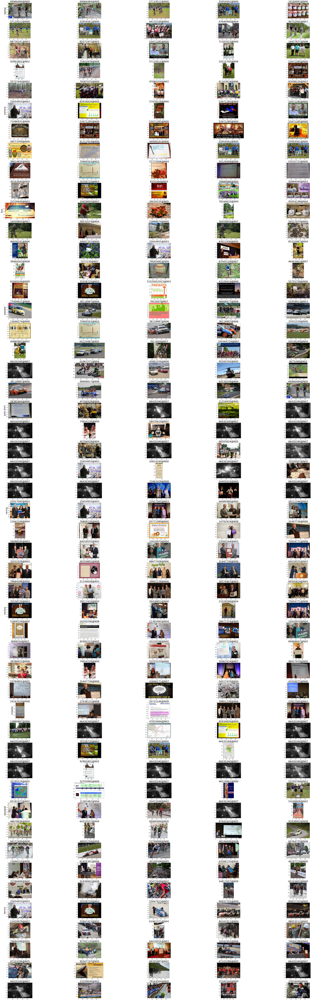

In [5]:
# /scratch/zhiqiu/yfcc100m_all/images_minbyte_10_valid_uploaded_date_feb_18/clip_dataset/bucket_11/query_photo_size_2000/sports_30/8/query_dict_8.pickle
from analyze_feature_variation import get_dataset_folder_paths
folder_path = '/scratch/zhiqiu/yfcc100m_all/images_minbyte_10_valid_uploaded_date_feb_18'
num_of_bucket = 11

# query_title = 'photo'
query_title = 'none'

avoid_multiple_class = True
class_size = 100
class_size = 300
nn_size = 8000
reverse_order = True
# reverse_order = False

avoid_multiple_class = False
class_size = 2000

# nn_size = 2048

LABEL_SETS = ['random', 'random2', 'vehicle_7', 'cifar10', 'tech_7_new', 'sports_30', 'fashion_25', 'cifar100', 'imagenet1K']


dataset_folder_paths_dict = get_dataset_folder_paths(folder_path, 
                                                     num_of_bucket, 
                                                     query_title, 
                                                     class_size, 
                                                     avoid_multiple_class, 
                                                     nn_size=nn_size,
                                                     reverse_order=reverse_order)

# label_set = "tech_7"
# label_set = "tech_7_new"
# label_set = "sports_30"
# label_set = "vehicle_7"
label_set = "dynamic"
# label_set = "random2"
# label_set = "cifar10"
# label_set = "fashion_25"
# main_label_set_path = dataset_folder_paths_dict[label_set]['main_label_set_path']

# a = plot_similiarity_for_single_class(dataset_folder_paths_dict, feature_name='clip_features', query='A photo of a bike', label_set='vehicle_7', top_samples=100)
top_samples = 500
# feature_means_dict = gather_feature_means(dataset_folder_paths_dict, label_set, top_samples=top_samples)
# plot_similiarity_for_single_class(feature_means_dict, feature_name='clip_features', query='A photo of a Archery', top_samples=class_size)
# plot_similiarity_for_single_class(feature_means_dict, feature_name='moco_features', query='cat', top_samples=500)
# plot_similiarity_for_single_class(feature_means_dict, feature_name='clip_features', query='cat', top_samples=500)
# plot_similiarity_for_single_class(feature_means_dict, feature_name='moco_features', query='bike', top_samples=100)
# plot_similiarity_for_single_class(feature_means_dict, feature_name='clip_features', query='bike', top_samples=100)
# plot_similiarity_for_label_set(feature_means_dict, feature_name='clip_features', bucket_idx=1, top_samples=class_size)
# plot_similiarity_for_label_set(feature_means_dict, feature_name='moco_features', bucket_idx=1, top_samples=class_size)
# a = plot_similiarity_for_single_class(
#         dataset_folder_paths_dict,
# #         feature_name='moco_features', query='A photo of a bike', label_set='vehicle_7', top_samples=100)
#         feature_name='clip_features', query='A photo of a cellphone', label_set='tech_7_new', top_samples=100)
# print(a)
# rank_similiarity_for_label_set(feature_means_dict, feature_name='moco_features', top_samples=top_samples)
# print()
# rank_similiarity_for_label_set(feature_means_dict, feature_name='clip_features', top_samples=top_samples)

# rank_similiarity_for_label_set_divide_by_internal_variation(feature_means_dict, feature_name='moco_features', top_samples=top_samples)
# print()
# rank_similiarity_for_label_set_divide_by_internal_variation(feature_means_dict, feature_name='clip_features', top_samples=top_samples)


sub_folder_paths = dataset_folder_paths_dict[label_set]['sub_folder_paths']

bucket_idx = 10
# bucket_idx = 5
bucket_idx = 9
# bucket_idx = 1
# bucket_idx = 0
save_path = os.path.join(sub_folder_paths[bucket_idx], f"query_dict_{bucket_idx}.pickle")
# print(save_path)
assert os.path.exists(save_path)
query_dict = load_pickle(save_path)
print(save_path)
ranks = range(0, 25)
# ranks = range(0, class_size-1, int(class_size/25))
print(list(ranks))
display_query_dict_random(query_dict, class_start=0, class_end=10, block_size=2, rank_list=list(ranks), show_info='USER_ID')
# display_query_dict_random(query_dict, class_start=10, class_end=20, block_size=2, rank_list=list(range(0, class_size-1, int(class_size/25))))
# display_query_dict_random(query_dict, class_start=20, class_end=30, block_size=2, rank_list=list(range(0, class_size-1, int(class_size/25))))

In [6]:
def debug_overlapping(dataset_folder_paths_dict, label_set, top_samples=2000):
    def get_ID_list(meta_list):
        ID_list = [meta.get_metadata().USER_ID for meta in meta_list]
        return ID_list
    
    sub_folder_paths = dataset_folder_paths_dict[label_set]['sub_folder_paths']
    num_of_bucket = len(sub_folder_paths)
    query_dict = {}
    for b_idx in range(num_of_bucket):
        save_path = os.path.join(sub_folder_paths[b_idx], f"query_dict_{b_idx}.pickle")
        assert os.path.exists(save_path)
        query_dict_i = load_pickle(save_path)
        query_dict[b_idx] = query_dict_i
        
    ID_dict = {}
    total_ID_set = set()
    total_ID_length = 0
    ID_overlap_dict = {} # Count the number of times an image appear in a class
    for b_idx in query_dict:
        for tag in query_dict[b_idx]:
            ID_dict[tag] = set(get_ID_list(query_dict[b_idx][tag]['metadata'][:top_samples]))
            total_ID_set = total_ID_set.union(ID_dict[tag])
            total_ID_length += len(ID_dict[tag])

        overlap_dict = {}
        for tag in ID_dict:
            overlap_dict[tag] = set()
            for tag_b in ID_dict:
                if tag_b != tag:
                    inter = ID_dict[tag].intersection(ID_dict[tag_b])
                    overlap_dict[tag] = overlap_dict[tag].union(inter)
        
        # Count number of times each image overlap
        for ID in overlap_dict[tag]:
            ID_overlap_dict[ID] = []
            for tag in ID_dict:
                for meta in query_dict[b_idx][tag]['metadata'][:top_samples]:
                    if meta.get_metadata().ID == ID:
                        ID_overlap_dict[ID].append((tag, b_idx, meta.get_path()))
        
                
        total_overlap_ID_set = set()
        for tag in overlap_dict:
            total_overlap_ID_set = total_overlap_ID_set.union(overlap_dict[tag])

    print(f"{len(total_ID_set)} / {total_ID_length} unique images")
    print(f"{len(total_overlap_ID_set)} out of {len(total_ID_set)} is appearing on multiple classes")
#     print(list(ID_overlap_dict.keys())
    overlap_IDs = sorted(list(ID_overlap_dict.keys()),
                         key=lambda x: len(ID_overlap_dict[x]),
                         reverse=True)
    
    num = 25
    list_of_files = [ID_overlap_dict[ID][0][2] for ID in overlap_IDs[:num]]
    score_list = [f"Appears in {str(len(ID_overlap_dict[ID]))} classes" for ID in overlap_IDs[:num]]
    show_images(list_of_files, fill=False, score_list=score_list)

def print_min_max_date(pickle_file):
    bucket_dict = load_pickle(pickle_file)
    for i in bucket_dict:
        print(f"Bucket {i}: {bucket_dict[i]['min_date']} to {bucket_dict[i]['max_date']}")


In [7]:
# debug_overlapping(dataset_folder_paths_dict,"dynamic", top_samples=100)

In [8]:
print_min_max_date("/scratch/zhiqiu/yfcc100m_all/images_minbyte_10_valid_uploaded_date_feb_18/bucket_11.pickle")

Bucket 0: 2004-01-01 11:52:13 to 2007-04-09 03:27:17
Bucket 1: 2007-04-09 03:27:33 to 2008-03-21 19:14:24
Bucket 2: 2008-03-21 19:14:37 to 2008-12-23 15:03:12
Bucket 3: 2008-12-23 15:03:36 to 2009-09-07 09:09:32
Bucket 4: 2009-09-07 09:09:43 to 2010-06-03 01:36:09
Bucket 5: 2010-06-03 01:36:29 to 2011-02-05 02:18:50
Bucket 6: 2011-02-05 02:19:02 to 2011-09-24 10:04:39
Bucket 7: 2011-09-24 10:06:13 to 2012-06-05 04:44:33
Bucket 8: 2012-06-05 04:44:46 to 2013-02-03 03:34:43
Bucket 9: 2013-02-03 03:34:45 to 2013-09-08 22:35:14
Bucket 10: 2013-09-08 22:35:26 to 2014-04-28 10:49:19


In [9]:
def plot_2d_matrix(matrix, label_ticks, title, min_acc=None, max_acc=None, normalize_by_column=False):
    if normalize_by_column:
        matrix = matrix / matrix.mean(axis=0).reshape(1,-1)
        cbar_str = "Test Accuracy / Average Test accuracy per column"
        format_score = lambda s : f"{s:.2f}"
    else:
        cbar_str = "Test Accuracy"
        format_score = lambda s : f"{s:.2%}"
    
    plt.figure(figsize=(10,10))
    x = ["Test " + n for n in label_ticks]
    y = ['Train ' + n for n in label_ticks]
    p = plt.imshow(matrix, interpolation='none', cmap=f'Greys', vmin=min_acc, vmax=max_acc)
    cbar = plt.colorbar()
    
   
    cbar.ax.set_ylabel(f"{cbar_str}", rotation=-90, va="bottom")
    cbar.ax.set_ylim(bottom=min_acc, top=max_acc)
#         cbar.ax.invert_yaxis()

    plt.xticks(range(len(x)), x, fontsize=11, rotation = -90)
    plt.yticks(range(len(y)), y, fontsize=11)
    plt.title(title, fontsize=15)
    for i in range(len(x)):
        for j in range(len(y)):
            text = plt.text(j, i, format_score(matrix[i, j]),
                       ha="center", va="center", color="r")

def eval_2d_matrix(matrix, normalize_by_column=False):
    if normalize_by_column:
        matrix = matrix / matrix.mean(axis=0).reshape(1,-1)
    backward_transfer = np.tril(matrix, k=-1)
    backward_transfer = np.sum(backward_transfer) / np.count_nonzero(backward_transfer)
    forward_transfer = np.triu(matrix, k=1)
    forward_transfer = np.sum(forward_transfer) / np.count_nonzero(forward_transfer)
    accuracy = np.diag(matrix)
    accuracy = np.mean(accuracy)
    return accuracy, backward_transfer, forward_transfer

def eval_2d_matrix_nap(matrix):
    matrix = matrix[0, :].reshape(1,-1)
    matrix = np.repeat(matrix, matrix.shape[1] ,axis=0)
    return eval_2d_matrix(matrix)

In [ ]:
# Plotting single experiment with seed == None
name =  "/scratch/zhiqiu/yfcc100m_all/images_minbyte_10_valid_uploaded_date_feb_18/clip_dataset_negative/bucket_11/"
# query_title = "photo"
query_title = "none"


data_split = "train_0.8_val_0.1_test_0.1"
# data_split = "train_0.7_test_0.3"

import analyze_linear_classification_new
from analyze_linear_classification_new import TRAIN_MODES_CATEGORY, MLP, get_seed_str

LABEL_SETS = ['dynamic_negative_300']
ALL_TRAIN_MODES = ['linear', 'mlp',
#                    'nearest_mean_normalized', 'cnn_scratch', 'cnn_imgnet', 'cnn_moco', 'cnn_byol', 'cnn_moco_yfcc_feb18_gpu_8_bucket_0',
                  'moco_v2_imgnet_linear', 'byol_imgnet_linear', 'imgnet_linear', 'moco_v2_yfcc_feb18_bucket_0_gpu_8_linear',
                  'moco_v2_imgnet_mlp', 'byol_imgnet_mlp', 'imgnet_mlp', 'moco_v2_yfcc_feb18_bucket_0_gpu_8_mlp',]

for train_mode in ALL_TRAIN_MODES:
    for label_set in LABEL_SETS:
        network_type = TRAIN_MODES_CATEGORY[train_mode].network_type
        feature_type = TRAIN_MODES_CATEGORY[train_mode].feature_type
        pretrained_weight = TRAIN_MODES_CATEGORY[train_mode].pretrained_weight
        for f_mode in ['', 'finetune_']:
            
            single_detail_str = f"{label_set}/results_dict_single_{f_mode}{data_split}_{train_mode}.pickle"


            result_dict_single = load_pickle(name + single_detail_str)
            if type(result_dict_single) == type(None):
                print(f"{name + single_detail_str} does not exist yet")
                continue
        
            try:
                all_bucket = [f"Bucket {i}" for i in list(result_dict_single['accuracy'].keys())]
            except:
                import pdb; pdb.set_trace()
                continue
        
            
            plot_2d_matrix(result_dict_single['b1_b2_accuracy_matrix'],
                           all_bucket,
                           title=f"Test Accuracy using {feature_type}: {train_mode}{f_mode}, {label_set}",
                           normalize_by_column=False,
#                               normalize_by_column=True,
    #                            min_acc=0., max_acc=1.)
            )
        
        

#             plot_2d_matrix(result_dict['single']['only_positive_accuracy_test'][feature_name],
#                            all_bucket,
#                            title=f"Test Accuracy (Positive Only) using {data_type}: {train_mode}, {label_set}",
#                           normalize_by_column=True,
# #                            min_acc=0., max_acc=1.)
#             )
#             plot_2d_matrix(result_dict['single']['avg_per_class_accuracy_test'][feature_name],
#                            all_bucket,
#                            title=f"Test Accuracy (Per Class Average) using {data_type}: {train_mode}, {label_set}",
#                           normalize_by_column=True,
# #                            min_acc=0., max_acc=1.)
#             )
            print(f"{f_mode} {feature_type} {label_set} {train_mode} {network_type} {pretrained_weight}")
            accuracy, backward_transfer, forward_transfer = eval_2d_matrix(result_dict_single['b1_b2_accuracy_matrix'])
            accuracy_nap, backward_transfer_nap, forward_transfer_nap = eval_2d_matrix_nap(result_dict_single['b1_b2_accuracy_matrix'])
            print(f"Present: {accuracy:.2%}; Backward: {backward_transfer:.2%}; Forward: {forward_transfer:.2%}")
            print(f"Present (NAP): {accuracy_nap:.2%}; Backward: {backward_transfer_nap:.2%}; Forward: {forward_transfer_nap:.2%}")
        all_detail_str = f"{label_set}/results_dict_all_{data_split}_{train_mode}_ex_0.pickle"
        result_dict_all = load_pickle(name + all_detail_str)
        if type(result_dict_all) == type(None):
            print(f"{train_mode} does not exist yet")
            import pdb; pdb.set_trace()
        print(f"Baseline: {result_dict_all['accuracy_matrix']['train']:.4%} (train acc), {result_dict_all['accuracy_matrix']['test']:.4%} (per sample test acc), {result_dict_all['only_positive_accuracy_test']:.4%} (pos only test acc), {result_dict_all['avg_per_class_accuracy_test']:.4%} (per class avg test acc)")



In [11]:
# Plotting all 5 experiment with seed 
name =  "/scratch/zhiqiu/yfcc100m_all/images_minbyte_10_valid_uploaded_date_feb_18/clip_dataset_negative/bucket_11/"
query_title = "none"


data_split = "train_0.8_val_0.1_test_0.1"
# data_split = "train_0.7_test_0.3"

import analyze_linear_classification_new
from analyze_linear_classification_new import TRAIN_MODES_CATEGORY, MLP, get_seed_str

LABEL_SETS = ['dynamic_negative_300']
ALL_TRAIN_MODES = ['linear', 'mlp',
#                    'nearest_mean_normalized', 'cnn_scratch', 'cnn_imgnet', 'cnn_moco', 'cnn_byol', 'cnn_moco_yfcc_feb18_gpu_8_bucket_0',
                  'moco_v2_imgnet_linear', 'byol_imgnet_linear', 'imgnet_linear', 'moco_v2_yfcc_feb18_bucket_0_gpu_8_linear',
                  'moco_v2_imgnet_mlp', 'byol_imgnet_mlp', 'imgnet_mlp', 'moco_v2_yfcc_feb18_bucket_0_gpu_8_mlp',]

seed_list = [None, 1, 10, 100, 1000]

for train_mode in ALL_TRAIN_MODES:
    for label_set in LABEL_SETS:
        network_type = TRAIN_MODES_CATEGORY[train_mode].network_type
        feature_type = TRAIN_MODES_CATEGORY[train_mode].feature_type
        pretrained_weight = TRAIN_MODES_CATEGORY[train_mode].pretrained_weight
        for f_mode in ['', 'finetune_']:
            b1_b2_accuracy_matrix = np.zeros((len(seed_list), 11,11))
            all_runs = {
                'baseline_train_acc' : np.zeros((len(seed_list))),
                'baseline_test_acc' : np.zeros((len(seed_list))),
            }
            for idx, seed in enumerate(seed_list):

                seed_str = get_seed_str(seed)
            
                single_detail_str = f"{label_set}/results_dict_single_{f_mode}{data_split}_{train_mode}{seed_str}.pickle"


                result_dict_single = load_pickle(name + single_detail_str)
                if type(result_dict_single) == type(None):
                    print(f"{name + single_detail_str} does not exist yet")
                    continue

                try:
                    all_bucket = [f"Bucket {i}" for i in list(result_dict_single['accuracy'].keys())]
                except:
                    import pdb; pdb.set_trace()
                    continue

                b1_b2_accuracy_matrix[idx] = result_dict_single['b1_b2_accuracy_matrix']
                
                all_detail_str = f"{label_set}/results_dict_all_{data_split}_{train_mode}{seed_str}_ex_0.pickle"
                result_dict_all = load_pickle(name + all_detail_str)
                if type(result_dict_all) == type(None):
                    print(f"{train_mode} does not exist yet")
                    import pdb; pdb.set_trace()
                    
                all_runs['baseline_train_acc'][idx] = result_dict_all['accuracy_matrix']['train']
                all_runs['baseline_test_acc'][idx] = result_dict_all['accuracy_matrix']['test']
                
            b1_b2_accuracy_matrix = b1_b2_accuracy_matrix.mean(axis=0)
            import pdb; pdb.set_trace()
            plot_2d_matrix(b1_b2_accuracy_matrix,
                           all_bucket,
                           title=f"Average of {len(seed_list)} runs: Test Accuracy using {feature_type}: {train_mode}{f_mode}, {label_set}",
                           normalize_by_column=False,
#                               normalize_by_column=True,
    #                            min_acc=0., max_acc=1.)
            )

            print(f"{f_mode} {feature_type} {label_set} {train_mode} {network_type} {pretrained_weight}")
            accuracy, backward_transfer, forward_transfer = eval_2d_matrix(b1_b2_accuracy_matrix)
            accuracy_nap, backward_transfer_nap, forward_transfer_nap = eval_2d_matrix_nap(b1_b2_accuracy_matrix)
            print(f"Present: {accuracy:.2%}; Backward: {backward_transfer:.2%}; Forward: {forward_transfer:.2%}")
            print(f"Present (NAP): {accuracy_nap:.2%}; Backward: {backward_transfer_nap:.2%}; Forward: {forward_transfer_nap:.2%}")
        
            print(f"{len(seed_list)} runs: Baseline: {all_runs['baseline_train_acc'].mean():.4%}+-{all_runs['baseline_train_acc'].std()} (train acc mean + std) ",
                      f"{all_runs['baseline_test_acc'][idx].mean():.4%}+-{all_runs['baseline_test_acc'][idx].std():.4%} (per sample test acc mean + std), ")
#                       f"{result_dict_all['only_positive_accuracy_test']:.4%} (pos only test acc), {result_dict_all['avg_per_class_accuracy_test']:.4%} (per class avg test acc)")
            


/scratch/zhiqiu/yfcc100m_all/images_minbyte_10_valid_uploaded_date_feb_18/clip_dataset_negative/bucket_11/dynamic_negative_300/results_dict_single_train_0.8_val_0.1_test_0.1_linear_seed_1.pickle does not exist yet
/scratch/zhiqiu/yfcc100m_all/images_minbyte_10_valid_uploaded_date_feb_18/clip_dataset_negative/bucket_11/dynamic_negative_300/results_dict_single_train_0.8_val_0.1_test_0.1_linear_seed_10.pickle does not exist yet
/scratch/zhiqiu/yfcc100m_all/images_minbyte_10_valid_uploaded_date_feb_18/clip_dataset_negative/bucket_11/dynamic_negative_300/results_dict_single_train_0.8_val_0.1_test_0.1_linear_seed_100.pickle does not exist yet
/scratch/zhiqiu/yfcc100m_all/images_minbyte_10_valid_uploaded_date_feb_18/clip_dataset_negative/bucket_11/dynamic_negative_300/results_dict_single_train_0.8_val_0.1_test_0.1_linear_seed_1000.pickle does not exist yet
> <ipython-input-11-d6b4f4d9d628>(62)<module>()
     60             b1_b2_accuracy_matrix = b1_b2_accuracy_matrix.mean(axis=0)
     61    

BdbQuit: 

In [ ]:
name =  "/scratch/zhiqiu/yfcc100m_all/images_minbyte_10_valid_uploaded_date_feb_18/clip_dataset/bucket_11/"
# query_title = "photo"
query_title = "none"

# nn_size = "2048"
# class_size = "100"
class_size = "300"
nn_size = "8000"

# data_split = "train_0.8_val_0.1_test_0.1"
data_split = "train_0.7_test_0.3"
reverse_str = ""
# reverse_str = "_reverse"

from analyze_linear_classification import TRAIN_MODES_CATEGORY
# LABEL_SETS = ['vehicle_7',  'cifar10', 'tech_7_new', 'sports_30', 'fashion_25', 'cifar100']
LABEL_SETS = ['dynamic']
ALL_TRAIN_MODES = ['linear', 'linear_wd', 'linear_normalized_projected', 'linear_normalized_projected_true',
                   'nearest_mean_normalized', 'cnn_scratch', 'cnn_imgnet', 'cnn_moco', 'cnn_byol',
                  'moco_v2_imgnet_linear', 'byol_imgnet_linear', 'imgnet_linear', 'moco_v2_yfcc_feb18_bucket_0_gpu_8_linear', 'cnn_moco_yfcc_feb18_gpu_8_bucket_0']
# for train_mode in ['nearest_mean', 'nearest_mean_normalized']:
for train_mode in ALL_TRAIN_MODES:
    for label_set in LABEL_SETS:
    #     label_set = "vehicle_7"
    #     train_mode = "nearest_mean" # or "linear"
#         train_mode = "linear" # or "linear"
        detail_str = f"query_{query_title}_size_{class_size}_nodup_nnsize_{nn_size}{reverse_str}/{label_set}/results_dict_{data_split}_{train_mode}_ex_0.pickle"


        result_dict = load_pickle(name + detail_str)
        if type(result_dict) == type(None):
            print(f"{train_mode} does not exist yet")
            continue
        if train_mode in TRAIN_MODES_CATEGORY['cnn']  + TRAIN_MODES_CATEGORY['cnn_linear_feature']:
            feature_names = ["metadata"]
        else:
#             feature_names = ['moco_features', 'clip_features']
            feature_names = ['clip_features']
        try:
            all_bucket = [f"Bucket {i}" for i in list(result_dict['single']['accuracy'][feature_names[0]].keys())]
        except:
            import pdb; pdb.set_trace()
            continue
        # print(result_dict['single']['b1_b2_accuracy_matrix']['moco_features'])
        for feature_name in feature_names:
            if feature_name == 'metadata':
                data_type = "Images"
            else:
                data_type = feature_name
            plot_2d_matrix(result_dict['single']['b1_b2_accuracy_matrix'][feature_name],
                           all_bucket,
                           title=f"Test Accuracy using {data_type}: {train_mode}, {label_set}",
                          normalize_by_column=True,
#                            min_acc=0., max_acc=1.)
            )
            print(f"{data_type} {label_set} {train_mode}")
            print(result_dict['all']['accuracy_matrix'][feature_name])
#         print(f"Clip {label_set} {train_mode}")
#         print(result_dict['all']['accuracy_matrix']['clip_features'])

In [ ]:
name =  "/scratch/zhiqiu/yfcc100m_all/images_minbyte_10_valid_uploaded_date_feb_18/clip_dataset_negative/bucket_11/"
# query_title = "photo"
query_title = "none"


# data_split = "train_0.8_val_0.1_test_0.1"
data_split = "train_0.7_test_0.3"

from analyze_linear_classification import TRAIN_MODES_CATEGORY
LABEL_SETS = ['dynamic_negative_300',  'dynamic_negative_3000']
ALL_TRAIN_MODES = ['linear', 
#                    'nearest_mean_normalized', 'cnn_scratch', 'cnn_imgnet', 'cnn_moco', 'cnn_byol', 'cnn_moco_yfcc_feb18_gpu_8_bucket_0',
#                   'moco_v2_imgnet_linear', 'byol_imgnet_linear', 'imgnet_linear', 
                   'moco_v2_yfcc_feb18_bucket_0_gpu_8_linear']

for train_mode in ALL_TRAIN_MODES:
    for label_set in LABEL_SETS:
        detail_str = f"{label_set}/results_dict_{data_split}_{train_mode}_ex_0.pickle"


        result_dict = load_pickle(name + detail_str)
        if type(result_dict) == type(None):
            print(f"{train_mode} does not exist yet")
            continue
        if train_mode in TRAIN_MODES_CATEGORY['cnn']  + TRAIN_MODES_CATEGORY['cnn_linear_feature']:
            feature_names = ["metadata"]
        else:
            feature_names = ['clip_features']
        try:
            all_bucket = [f"Bucket {i}" for i in list(result_dict['single']['accuracy'][feature_names[0]].keys())]
        except:
            import pdb; pdb.set_trace()
            continue
        for feature_name in feature_names:
            if feature_name == 'metadata':
                data_type = "Images"
            else:
                data_type = feature_name
            plot_2d_matrix(result_dict['single']['b1_b2_accuracy_matrix'][feature_name],
                           all_bucket,
                           title=f"Test Accuracy using {data_type}: {train_mode}, {label_set}",
                           normalize_by_column=True,
#                            min_acc=0., max_acc=1.)
            )
            plot_2d_matrix(result_dict['single']['only_positive_accuracy_test'][feature_name],
                           all_bucket,
                           title=f"Test Accuracy (Positive Only) using {data_type}: {train_mode}, {label_set}",
                          normalize_by_column=True,
#                            min_acc=0., max_acc=1.)
            )
            plot_2d_matrix(result_dict['single']['avg_per_class_accuracy_test'][feature_name],
                           all_bucket,
                           title=f"Test Accuracy (Per Class Average) using {data_type}: {train_mode}, {label_set}",
                          normalize_by_column=True,
#                            min_acc=0., max_acc=1.)
            )
            print(f"{data_type} {label_set} {train_mode}")
            all_models_dict = result_dict['all']
            print(f"Baseline: {all_models_dict['accuracy_matrix'][feature_name]['train']:.4%} (train acc), {all_models_dict['accuracy_matrix'][feature_name]['test']:.4%} (per sample test acc), {all_models_dict['only_positive_accuracy_test'][feature_name]:.4%} (pos only test acc), {all_models_dict['avg_per_class_accuracy_test'][feature_name]:.4%} (per class avg test acc)")
